In [3]:
import torch
import torch.optim as optim
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import sklearn
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import csv
import math
import scipy

import dataset
import datasplit
import model.models as models
import trainer
import utils

# TEST on POLY RANDOM

In [4]:
# # BEST RESULTS
# print('Best Train Accuracy: ', 100 * max(all_train_correct) / train_set_size)
# print('Epoch: ', np.argmax(all_train_correct))
# print()
# print('Best Val Accuracy: ', 100 * max(all_val_correct) / val_set_size)
# print('Epoch: ', np.argmax(all_val_correct))
# print()
# print('Best Test Accuracy: ', 100 * max(all_test_correct) / test_set_size)
# print('Epoch: ', np.argmax(all_test_correct))
# print()

In [5]:
# folders
models_folder = '../../saved/models'
model_name = '20201022_setnetcond_tanh_poly_rnd_bg_best'
results_folder = '../../saved/results'
results_subfolder = '20201022_setnetcond_tanh_poly_rnd_bg'

# load model
setnetcond = torch.load('%s/%s' % (models_folder, model_name), map_location=torch.device('cpu'))

# load results
all_train_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_train_losses.npy')), allow_pickle=True)
all_train_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_train_correct.npy')), allow_pickle=True)
best_train_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_train_results.npy')), allow_pickle=True)

all_val_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_val_losses.npy')), allow_pickle=True)
all_val_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_val_correct.npy')), allow_pickle=True)
best_val_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_val_results.npy')), allow_pickle=True)

all_test_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_test_losses.npy')), allow_pickle=True)
all_test_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_test_correct.npy')), allow_pickle=True)
best_test_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_test_results.npy')), allow_pickle=True)

fx_labels = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'fx_labels.npy')), allow_pickle=True)

# datasets sizes
train_set_size = best_train_results.shape[0]
val_set_size = best_val_results.shape[0]
test_set_size = best_test_results.shape[0]

# example
best_train_results[0]

array([102142, 'P95-56240-SD1-D8.6T4.8-41558',
       array([1.   , 0.858, 0.49 ], dtype=float32),
       array([1.  , 0.86, 0.48], dtype=float32)], dtype=object)

In [6]:
# Find best performance epoch based on validation
# Extract results from training and test for that epoch
best_val = 100 * max(all_val_correct) / val_set_size
best_val_idx = np.argmax(all_val_correct)

print("Best Validation Accuracy: ",best_val, "at epoch ", best_val_idx)
print("Training Accuracy: ", 100 * all_train_correct[best_val_idx] / train_set_size)
print("Test Accuracy: ", 100 * all_test_correct[best_val_idx] / test_set_size)

Best Validation Accuracy:  97.28846153846153 at epoch  83
Training Accuracy:  96.43055555555556
Test Accuracy:  97.00769230769231


In [7]:
# LOSS
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, all_train_losses, 'b', label='Train loss')
# plt.plot(epochs, all_val_losses, 'r', label='Validation loss')
# plt.plot(epochs, all_test_losses, 'g', label='Test loss')
# plt.title('Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [8]:
# NORMALISED LOSS
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, np.array(all_train_losses) / max(all_train_losses), 'b', label='Train loss')
# plt.plot(epochs, np.array(all_val_losses) / max(all_val_losses), 'r', label='Validation loss')
# plt.plot(epochs, np.array(all_test_losses) / max(all_test_losses), 'g', label='Test loss')
# plt.title('Normalised Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [9]:
# ACCURACY
# all_train_perc_correct = 100 * np.array(all_train_correct) / train_set_size
# all_val_perc_correct = 100 * np.array(all_val_correct) / val_set_size
# all_test_perc_correct = 100 * np.array(all_test_correct) / test_set_size
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, all_train_perc_correct, 'b', label='Train acc')
# plt.plot(epochs, all_val_perc_correct, 'r', label='Validation acc')
# plt.plot(epochs, all_test_perc_correct, 'g', label='Test acc')
# plt.title('Accuracy')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [10]:
# dataframe
test_indexes_poly_rnd = best_test_results[:, 0]
test_filenames_poly_rnd = best_test_results[:, 1] 
test_preds_poly_rnd = np.stack(best_test_results[:, 2])
test_targets_poly_rnd = np.stack(best_test_results[:, 3])
test_abs_err_poly_rnd = np.stack(abs(test_preds_poly_rnd - test_targets_poly_rnd))
test_err_poly_rnd = np.stack(test_preds_poly_rnd - test_targets_poly_rnd)

# dataframes
test_df_poly_rnd = pd.DataFrame(data={
                                'index': test_indexes_poly_rnd, 
                                'filename': test_filenames_poly_rnd,
                                'level_pred': test_preds_poly_rnd[:,0], 
                                'gain_pred': test_preds_poly_rnd[:,1],
                                'tone_eq1_pred': test_preds_poly_rnd[:,2], 
                                'level_targ': test_targets_poly_rnd[:,0], 
                                'gain_targ': test_targets_poly_rnd[:,1],
                                'tone_eq1_targ': test_targets_poly_rnd[:,2], 
                                'level_err': test_err_poly_rnd[:,0], 
                                'gain_err': test_err_poly_rnd[:,1],
                                'tone_eq1_err': test_err_poly_rnd[:,2], 
                                'level_abs': test_abs_err_poly_rnd[:,0], 
                                'gain_abs': test_abs_err_poly_rnd[:,1],
                                'tone_eq1_abs': test_abs_err_poly_rnd[:,2], 
                                })

print(len(test_df_poly_rnd))
test_df_poly_rnd[:3]

26000


,index,filename,level_pred,gain_pred,tone_eq1_pred,level_targ,gain_targ,tone_eq1_targ,level_err,gain_err,tone_eq1_err,level_abs,gain_abs,tone_eq1_abs
0,48966,P94-57160-DS1-D9.9T2-41484,1.0,0.967,0.183,1.0,0.99,0.20,0.0,-0.023,-0.017,0.0,0.023,0.017
1,105534,P64-57130-SD1-D3.3T9.1-41229,1.0,0.305,0.881,1.0,0.33,0.91,0.0,-0.025,-0.029,0.0,0.025,0.029
2,87959,P94-56120-RAT-D5.2F1.5-41423,1.0,0.500,0.152,1.0,0.52,0.15,0.0,-0.020,0.002,0.0,0.020,0.002


In [11]:
# Mean Absolute Errors
level_mae_poly_rnd = sum(test_df_poly_rnd.level_abs)/test_set_size
gain_mae_poly_rnd = sum(test_df_poly_rnd.gain_abs)/test_set_size
tone_eq1_mae_poly_rnd = sum(test_df_poly_rnd.tone_eq1_abs)/test_set_size

print('level_mae: ', level_mae_poly_rnd)
print('gain_mae: ', gain_mae_poly_rnd)
print('tone_eq1_mae: ', tone_eq1_mae_poly_rnd)

# Root Mean Squared Errors
level_rmse_poly_rnd = math.sqrt(sum(test_df_poly_rnd.level_abs**2)/test_set_size)
gain_rmse_poly_rnd = math.sqrt(sum(test_df_poly_rnd.gain_abs**2)/test_set_size)
tone_eq1_rmse_poly_rnd = math.sqrt(sum(test_df_poly_rnd.tone_eq1_abs**2)/test_set_size)

print('level_rmse: ', level_rmse_poly_rnd)
print('gain_rmse: ', gain_rmse_poly_rnd)
print('tone_eq1_rmse: ', tone_eq1_rmse_poly_rnd)

level_mae:  1.923052164224478e-07
gain_mae:  0.020269692412505928
tone_eq1_mae:  0.0184558848461378
level_rmse:  1.3867326736516013e-05
gain_rmse:  0.027470258091920937
tone_eq1_rmse:  0.034012664664495255


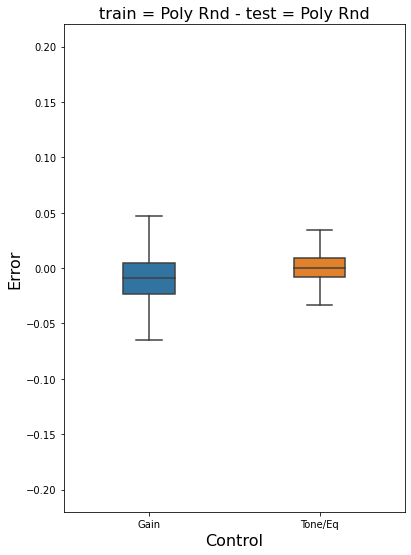

In [12]:
# box plot
err_df_poly_rnd = pd.DataFrame(data={
                        'Gain': test_df_poly_rnd['gain_err'],
                        'Tone/Eq': test_df_poly_rnd['tone_eq1_err'],
                        })

plt.figure(figsize=(6,8))

ax = sns.boxplot(x="variable", y="value", data=pd.melt(err_df_poly_rnd), width=0.3, showfliers = False, fliersize=2)

plt.title('train = Poly Rnd - test = Poly Rnd', fontsize=16)

plt.xlabel('Control', fontsize=16)
plt.ylabel('Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('font', size=16) 

plt.tight_layout()
ax.set(ylim=(-0.22,0.22))
plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_polyrnd_polyrnd_bp.eps'), format='eps')

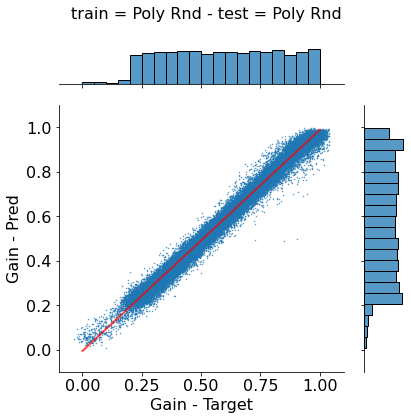

In [33]:
# scatter plot
ax = sns.jointplot(x="gain_targ", y="gain_pred", data=test_df_poly_rnd, marker='.', x_jitter=0.04, kind="reg", space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=20))

ax.fig.suptitle('train = Poly Rnd - test = Poly Rnd', fontsize=16)

plt.xlabel('Gain - Target', fontsize=16)
plt.ylabel('Gain - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_polyrnd_polyrnd_gain_sp.png'), format='png')

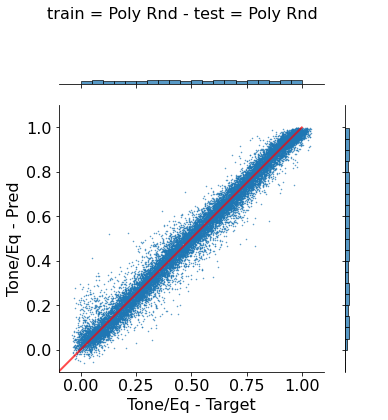

In [34]:
# scatter plot
ax = sns.jointplot(x="tone_eq1_targ", y="tone_eq1_pred", data=test_df_poly_rnd, marker='.', x_jitter=0.04, kind="reg", space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=40))

ax.fig.suptitle('train = Poly Rnd - test = Poly Rnd', fontsize=16)

plt.xlabel('Tone/Eq - Target', fontsize=16)
plt.ylabel('Tone/Eq - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_polyrnd_polyrnd_tone_sp.png'), format='png')

(-0.15, 0.15)

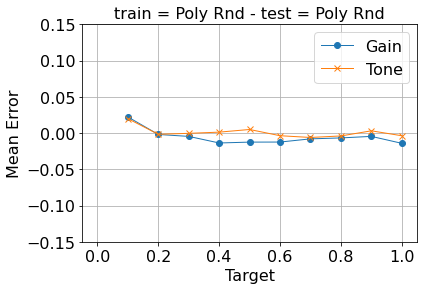

In [15]:
# mean error plot
step_size = 0.1
steps = np.linspace(start=0, stop=1, num=int(1/step_size + 1))
avg_err_gain = []
avg_err_tone = []

for n in range(len(steps)-1):
    df = test_df_poly_rnd[(test_df_poly_rnd['gain_targ'] >= steps[n]) & (test_df_poly_rnd['gain_targ'] < steps[n+1])]
    avg_err_gain.append(sum(df['gain_err']) / len(df))

for n in range(len(steps)-1):
    df = test_df_poly_rnd[(test_df_poly_rnd['tone_eq1_targ'] >= steps[n]) & (test_df_poly_rnd['tone_eq1_targ'] < steps[n+1])]
    avg_err_tone.append(sum(df['tone_eq1_err']) / len(df))

plt.plot(steps[1:], avg_err_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps[1:], avg_err_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Poly Rnd - test = Poly Rnd', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Mean Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.15, 0.15])

(-5.0, 5.0)

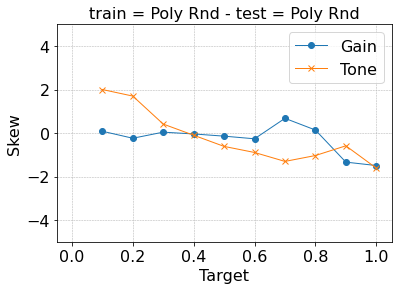

In [16]:
# skew
step_size = 0.1
steps = np.linspace(start=0, stop=1, num=int(1/step_size + 1))
skew_gain = []
skew_tone = []

for n in range(len(steps)-1):
    df = test_df_poly_rnd[(test_df_poly_rnd['gain_targ'] >= steps[n]) & (test_df_poly_rnd['gain_targ'] < steps[n+1])]
    skew_gain.append(scipy.stats.skew(df['gain_err']))

for n in range(len(steps)-1):
    df = test_df_poly_rnd[(test_df_poly_rnd['tone_eq1_targ'] >= steps[n]) & (test_df_poly_rnd['tone_eq1_targ'] < steps[n+1])]
    skew_tone.append(scipy.stats.skew(df['tone_eq1_err']))

plt.plot(steps[1:], skew_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps[1:], skew_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Poly Rnd - test = Poly Rnd', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Skew', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

plt.xlim([-0.05, 1.05])
plt.ylim([-5, 5])

# TEST on POLY

In [17]:
# dataset
dataset_poly = dataset.FxDataset(
                            root='/Volumes/Macintosh HD/DATASETS/GUITAR-FX/Poly',
                            excl_folders=['MT2'], 
                            spectra_folder='mel_22050_1024_512', 
                            processed_settings_csv='proc_settings.csv',
                            max_num_settings=3,
                            transform=transforms.Compose([transforms.ToTensor()])
                            )

dataset_poly.init_dataset()
# dataset_mono_rnd.generate_mel()

# split
# set test_train_split=0.0 and val_train_split=0.0 to test pre-trained model
split_poly = datasplit.DataSplit(dataset_poly, test_train_split=0.0, val_train_split=0.0, shuffle=True)

# loaders
_, _, test_loader_poly = split_poly.get_split(batch_size=100)

len(dataset_poly)

83160

In [18]:
# test
test_poly_loss, test_poly_correct, test_poly_results = trainer.test_settings_cond_net(
        model=setnetcond, 
        test_loader=test_loader_poly, 
        test_sampler=split_poly.test_sampler,
        loss_function=nn.MSELoss(), 
        device='cpu'
    )

# example
test_poly_results[0]

====> Test Loss: 2.1873	 Avg Loss: 0.0000	Correct: 73953/83160	Percentage Correct: 88.93


(61199,
 'P65-50240-RBM-T10S2-41342',
 array([1.   , 0.181, 0.984], dtype=float32),
 array([1. , 0.2, 1. ], dtype=float32))

In [19]:
# dataframe
test_results_npy_poly = np.array(test_poly_results)
test_indexes_poly = test_results_npy_poly[:, 0]
test_filenames_poly = test_results_npy_poly[:, 1] 
test_preds_poly = np.stack(test_results_npy_poly[:, 2])
test_targets_poly = np.stack(test_results_npy_poly[:, 3])
test_abs_err_poly = np.stack(abs(test_preds_poly - test_targets_poly))
test_err_poly = np.stack(test_preds_poly - test_targets_poly)

test_df_poly = pd.DataFrame(data={'index': test_indexes_poly, 
                                        'filename': test_filenames_poly,
                                        'level_pred': test_preds_poly[:,0], 
                                        'gain_pred': test_preds_poly[:,1],
                                        'tone_eq1_pred': test_preds_poly[:,2], 
                                       'level_targ': test_targets_poly[:,0], 
                                        'gain_targ': test_targets_poly[:,1],
                                        'tone_eq1_targ': test_targets_poly[:,2], 
                                        'level_err': test_err_poly[:,0], 
                                        'gain_err': test_err_poly[:,1],
                                        'tone_eq1_err': test_err_poly[:,2], 
                                        'level_abs': test_abs_err_poly[:,0], 
                                        'gain_abs': test_abs_err_poly[:,1],
                                        'tone_eq1_abs': test_abs_err_poly[:,2], 
                                        })
print(len(test_df_poly))
test_df_poly[:3]

83160


,index,filename,level_pred,gain_pred,tone_eq1_pred,level_targ,gain_targ,tone_eq1_targ,level_err,gain_err,tone_eq1_err,level_abs,gain_abs,tone_eq1_abs
0,61199,P65-50240-RBM-T10S2-41342,1.0,0.181,0.984,1.0,0.2,1.0,0.0,-0.019,-0.016,0.0,0.019,0.016
1,71435,P64-50150-SD1-D8T10-41252,1.0,0.819,0.976,1.0,0.8,1.0,0.0,0.019,-0.024,0.0,0.019,0.024
2,26585,P65-46270-DPL-D8-41383,1.0,0.800,-1.000,1.0,0.8,-1.0,0.0,0.000,0.000,0.0,0.000,0.000


In [20]:
# Mean Absolute Errors
level_mae_poly = sum(test_df_poly.level_abs)/len(dataset_poly)
gain_mae_poly = sum(test_df_poly.gain_abs)/len(dataset_poly)
tone_eq1_mae_poly = sum(test_df_poly.tone_eq1_abs)/len(dataset_poly)

print('level_mae: ', level_mae_poly)
print('gain_mae: ', gain_mae_poly)
print('tone_eq1_mae: ', tone_eq1_mae_poly)

# Root Mean Squared Errors
level_rmse_poly = math.sqrt(sum(test_df_poly.level_abs**2)/len(dataset_poly))
gain_rmse_poly = math.sqrt(sum(test_df_poly.gain_abs**2)/len(dataset_poly))
tone_eq1_rmse_poly = math.sqrt(sum(test_df_poly.tone_eq1_abs**2)/len(dataset_poly))

print('level_rmse: ', level_rmse_poly)
print('gain_rmse: ', gain_rmse_poly)
print('tone_eq1_rmse: ', tone_eq1_rmse_poly)

level_mae:  1.4429828649303442e-07
gain_mae:  0.036356974511791505
tone_eq1_mae:  0.03568969433189702
level_rmse:  1.2012345166523459e-05
gain_rmse:  0.06319001263880135
tone_eq1_rmse:  0.062407618015094535


[(-0.22, 0.22)]

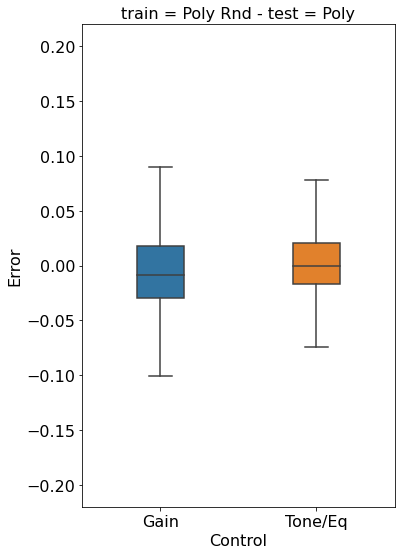

In [21]:
# box plot
err_df_poly = pd.DataFrame(data={
                        'Gain': test_df_poly['gain_err'],
                        'Tone/Eq': test_df_poly['tone_eq1_err'],
                        })

plt.figure(figsize=(6,8))
ax = sns.boxplot(x="variable", y="value", data=pd.melt(err_df_poly), width=0.3, showfliers = False, fliersize=2)

plt.title('train = Poly Rnd - test = Poly', fontsize=16)

plt.xlabel('Control', fontsize=16)
plt.ylabel('Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('font', size=16) 

plt.tight_layout()
ax.set(ylim=(-0.22,0.22))

<Figure size 720x720 with 0 Axes>

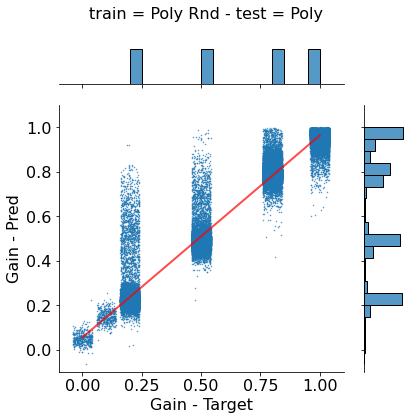

In [31]:
# scatter plot
plt.figure(figsize=(10,10))

ax = sns.jointplot(x="gain_targ", y="gain_pred", data=test_df_poly, kind="reg", marker='.', x_jitter=0.04, space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=20))

ax.fig.suptitle('train = Poly Rnd - test = Poly', fontsize=16)

plt.xlabel('Gain - Target', fontsize=16)
plt.ylabel('Gain - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_polyrnd_poly_gain_sp.png'), format='png')

<Figure size 720x720 with 0 Axes>

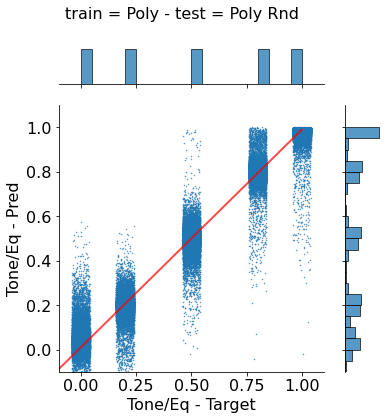

In [32]:
# scatter plot
plt.figure(figsize=(10,10))
ax = sns.jointplot(x="tone_eq1_targ", y="tone_eq1_pred", data=test_df_poly, kind="reg", marker='.', x_jitter=0.04, space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=40))

ax.fig.suptitle('train = Poly - test = Poly Rnd', fontsize=16)

plt.xlabel('Tone/Eq - Target', fontsize=16)
plt.ylabel('Tone/Eq - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_polyrnd_poly_tone_sp.png'), format='png')

[ 0.049  0.048  0.041 -0.003 -0.003 -0.043]
[ 0.047 -0.004 -0.002  0.001 -0.028]


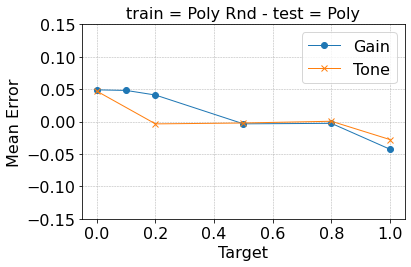

In [24]:
# mean error plot
steps_gain = [0.0, 0.1, 0.2, 0.5, 0.8, 1.0]
steps_tone = [0.0, 0.2, 0.5, 0.8, 1.0]
avg_err_gain = []
avg_err_tone = []

for n in range(len(steps_gain)):
    df = test_df_poly[test_df_poly['gain_targ'] == steps_gain[n]]
    avg_err_gain.append(sum(df['gain_err']) / len(df))

for n in range(len(steps_tone)):
    df = test_df_poly[test_df_poly['tone_eq1_targ'] == steps_tone[n]]
    avg_err_tone.append(sum(df['tone_eq1_err']) / len(df))

print(np.around(avg_err_gain, 3))
print(np.around(avg_err_tone, 3))

plt.plot(steps_gain, avg_err_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps_tone, avg_err_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Poly Rnd - test = Poly', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Mean Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.15, 0.15])

plt.tight_layout()
plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_polyrnd_poly_me.eps'), format='eps')

[ 0.736  0.079  3.957  3.629  0.87  -2.664]
[ 0. -1.  0. -1.  0.]


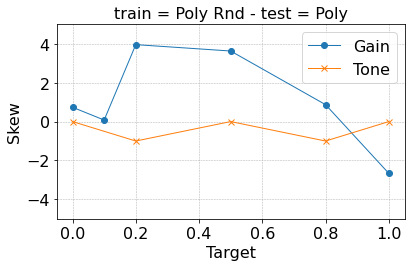

In [25]:
# skew
steps_gain = [0.0, 0.1, 0.2, 0.5, 0.8, 1.0]
steps_tone = [0.0, 0.2, 0.5, 0.8, 1.0]
skew_gain = []
skew_tone = []

for n in range(len(steps_gain)):
    df = test_df_poly[test_df_poly['gain_targ'] == steps_gain[n]]
    skew_gain.append(scipy.stats.skew(df['gain_err']))

for n in range(len(steps_tone)):
    df = test_df_poly[test_df_poly['tone_eq1_targ'] == steps_tone[n]]
    skew_tone.append(scipy.stats.skew(df['tone_eq1_targ']))

print(np.around(skew_gain, 3))
print(np.around(skew_tone, 3))

plt.plot(steps_gain, skew_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps_tone, skew_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Poly Rnd - test = Poly', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Skew', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

plt.xlim([-0.05, 1.05])
plt.ylim([-5, 5])

plt.tight_layout()
plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_polyrnd_poly_sk.eps'), format='eps')

# TEST on MONO

In [26]:
# # dataset
# dataset_mono = dataset.FxDataset(
#                             root='/Volumes/Macintosh HD/DATASETS/GUITAR-FX/Mono',
#                             excl_folders=['NoFX_mono', 'NoFX_mono_preprocessed', 'MT2'], 
#                             spectra_folder='mel_22050_1024_512', 
#                             processed_settings_csv='proc_settings.csv',
#                             max_num_settings=3,
#                             transform=transforms.Compose([transforms.ToTensor()])
#                             )

# dataset_mono.init_dataset()
# # dataset_mono_rnd.generate_mel()

# # split
# # set test_train_split=0.0 and val_train_split=0.0 to test pre-trained model
# split_mono = datasplit.DataSplit(dataset_mono, test_train_split=0.0, val_train_split=0.0, shuffle=True)

# # loaders
# _, _, test_loader_mono = split_mono.get_split(batch_size=100)

# len(dataset_mono)

In [27]:
# test_mono_loss, test_mono_correct, test_moo_results = trainer.test_settings_cond_net(
#         model=setnetcond, 
#         test_loader=test_loader_mono, 
#         test_sampler=split_mono.test_sampler,
#         loss_function=nn.MSELoss(), 
#         device='cpu'
#     )

# TEST on MONO RND

In [28]:
# # dataset
# dataset_mono_rnd_bg = dataset.FxDataset(
#                             root='/Volumes/Macintosh HD/DATASETS/GUITAR-FX/Mono_Random_Bg',
#                             excl_folders=['MT2'], 
#                             spectra_folder='mel_22050_1024_512', 
#                             processed_settings_csv='proc_settings.csv',
#                             max_num_settings=3,
#                             transform=transforms.Compose([transforms.ToTensor()])
#                             )

# dataset_mono_rnd_bg.init_dataset()
# # dataset_mono_rnd.generate_mel()

# # split
# # set test_train_split=0.0 and val_train_split=0.0 to test pre-trained model
# split_mono_rnd_bg = datasplit.DataSplit(dataset_mono_rnd_bg, test_train_split=0.0, val_train_split=0.0, shuffle=True)

# # loaders
# _, _, test_loader_mono_rnd_bg = split_mono_rnd_bg.get_split(batch_size=100)

# len(dataset_mono_rnd_bg)

In [29]:
# test_mono_rnd_bg_loss, test_mono_rnd_bg_correct, test_mono_rnd_bg_results = trainer.test_settings_cond_net(
#         model=setnetcond, 
#         test_loader=test_loader_mono_rnd_bg, 
#         test_sampler=split_mono_rnd_bg.test_sampler,
#         loss_function=nn.MSELoss(), 
#         device='cpu'
#     )